In [1]:
import sys
sys.path.insert(0, "../modules")
import ds
import slow_fast as sf
import surrogate as sr
import numpy as np

In [48]:
params = [6.0, 0.0, 0.1, -4.5, 0.0, -4.5, 0.01]
nnHyperparams = [4, 2048, 1]
device = "cuda"
dynamicalSystem = ds.DynamicalSystem(sf.fullHamSys, params, sf.balance)
dynamicalSystem.solve(x0=sf.x0, tEnd=100, numEvals=50000);
surrogateModel = sr.Surrogate(nnHyperparams, device)
surrogateModel.train(dynamicalSystem.soln.y.T.astype(np.float32), numEpochs=25, learningRate=1e-4)

Time taken by solve is 5.7786 s.


Epoch 1/25 | Mean Loss: 2231.718543

Epoch 2/25 | Mean Loss: 473.245377

Epoch 3/25 | Mean Loss: 161.135165

Epoch 4/25 | Mean Loss: 102.605984

Epoch 5/25 | Mean Loss: 69.667638

Epoch 6/25 | Mean Loss: 43.274610

Epoch 7/25 | Mean Loss: 27.193595

Epoch 8/25 | Mean Loss: 18.661941

Epoch 9/25 | Mean Loss: 13.943280

Epoch 10/25 | Mean Loss: 11.048538

Epoch 11/25 | Mean Loss: 9.119774

Epoch 12/25 | Mean Loss: 7.761909

Epoch 13/25 | Mean Loss: 6.760224

Epoch 14/25 | Mean Loss: 5.980383

Epoch 15/25 | Mean Loss: 5.318620

Epoch 16/25 | Mean Loss: 4.748412

Epoch 17/25 | Mean Loss: 4.236782

Epoch 18/25 | Mean Loss: 3.760547

Epoch 19/25 | Mean Loss: 3.328746

Epoch 20/25 | Mean Loss: 2.927733

Epoch 21/25 | Mean Loss: 2.554388

Epoch 22/25 | Mean Loss: 2.203348

Epoch 23/25 | Mean Loss: 1.896011

Epoch 24/25 | Mean Loss: 1.616254

Epoch 25/25 | Mean Loss: 1.372148Time taken by train is 81.4851 s.


Time taken by plotSolution is 12.7088 s.


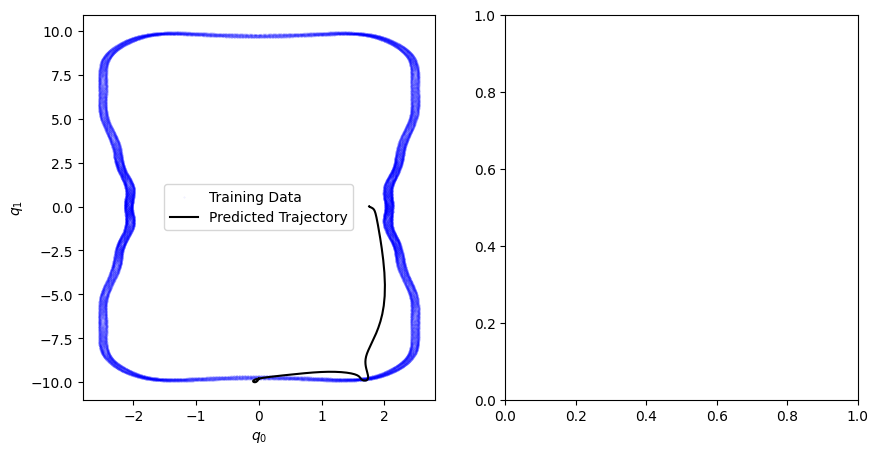

In [44]:
predictedTrajectory = surrogateModel.plotExperiment(numSteps=50000)

In [21]:
predictedTrajectory[-1]

array([ 4.9990080e-02, -1.0156010e+01,  5.0235046e+01,  3.1529897e-01],
      dtype=float32)

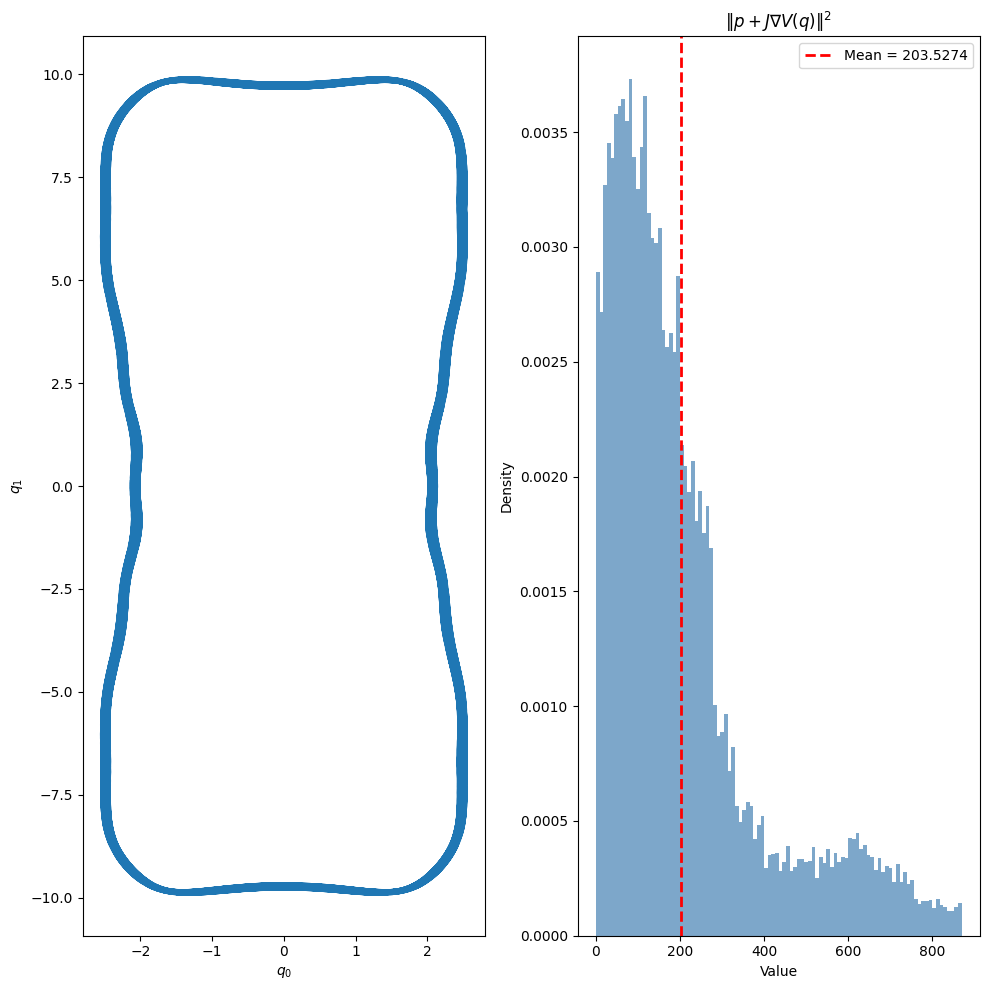

In [5]:
b = dynamicalSystem.plotSolution(constraintLabel=r"$\|p+J\nabla V(q)\|^2$")

In [6]:
b = dynamicalSystem.plotSolutionAnimated(constraintLabel=r"$\|p+J\nabla V(q)\|^2$")

Animation size has reached 20983698 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Time taken by plotSolutionAnimated is 152.6748 s.


In [24]:
import torchsummary

ModuleNotFoundError: No module named 'torchsummary'

In [25]:
!pip install torchsummary

  Obtaining dependency information for torchsummary from https://files.pythonhosted.org/packages/7d/18/1474d06f721b86e6a9b9d7392ad68bed711a02f3b61ac43f13c719db50a6/torchsummary-1.5.1-py3-none-any.whl.metadata


In [27]:
from torchsummary import summary
summary(surrogateModel.model, (4, ))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
          LSTMCell-1     [[-1, 256], [-1, 256]]               0
          LSTMCell-2     [[-1, 256], [-1, 256]]               0
            Linear-3                    [-1, 4]           1,028
Total params: 1,028
Trainable params: 1,028
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 1.00
Params size (MB): 0.00
Estimated Total Size (MB): 1.00
----------------------------------------------------------------


In [32]:
print(sum(p.numel() for p in surrogateModel.model.parameters() if p.requires_grad))

795652


In [47]:
np.linspace(0.0, 20., 5000)

array([0.00000000e+00, 4.00080016e-03, 8.00160032e-03, ...,
       1.99919984e+01, 1.99959992e+01, 2.00000000e+01])